# Imputing Missing values using KNN imputer

In [116]:
# from sklearn.impute import KNNImputer
# imputer = KNNImputer(n_neighbors = 5)
# df_imp = imputer.fit_transform(df)
# df_new = pd.DataFrame(df_imp)
# df_new.columns = df.columns

In [117]:
df_new = df.copy()

In [118]:
for col in df_new.columns:
    if df_new[col].isnull().any():
        nearest_neighbors = df_new[[col] + [c for c in df_new.columns if not df_new[c].isnull().any()]][:5]
        most_common = nearest_neighbors.mode().iloc[0, 0]
        df_new.loc[df_new[col].isnull(), col] = most_common

In [119]:
# df_new.to_csv("No_show_imputed.csv")

In [120]:
# df_new = pd.read_csv("No_show_imputed.csv")
df_new.head()

,Gender,Age,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show,Waitingperiod,total_appointments,prior_appointments,regular_patient,total_no_shows,prior_no_shows,Neighbourhood_Group1,Neighbourhood_Group2,Neighbourhood_Group3,Neighbourhood_Group4,Neighbourhood_Group5,Neighbourhood_Group6,Neighbourhood_Group7
0,0,56.000000,0.000000,1,0,0.000000,0.000000,0.000000,0,0.000000,1.000000,0.000000,0,0.000000,0.000000,0,0,1,0,0,0,0
1,1,56.000000,0.000000,0,0,0.000000,0.000000,0.000000,0,0.000000,2.000000,1.000000,1,0.000000,0.000000,0,0,1,0,0,0,0
2,0,62.000000,0.000000,0,0,0.000000,0.000000,0.000000,0,0.000000,1.000000,0.000000,0,0.000000,0.000000,1,0,0,0,0,0,0
3,0,8.000000,0.000000,0,0,0.000000,0.000000,0.000000,0,0.000000,2.000000,1.000000,1,1.000000,0.000000,1,0,0,0,0,0,0
4,0,56.000000,0.000000,1,1,0.000000,0.000000,0.000000,0,0.000000,1.000000,0.000000,0,0.000000,0.000000,0,0,1,0,0,0,0


In [121]:
df_new.isnull().sum().any()

False

All null values has been imputed with KNN imputer with k=5.

In [122]:
df_new.nunique()

Gender                    2
Age                     103
Scholarship               2
Hipertension              2
Diabetes                  2
Alcoholism                2
Handcap                   2
SMS_received              2
No-show                   2
Waitingperiod            41
total_appointments       41
prior_appointments       40
regular_patient           2
total_no_shows           16
prior_no_shows           15
Neighbourhood_Group1      2
Neighbourhood_Group2      2
Neighbourhood_Group3      2
Neighbourhood_Group4      2
Neighbourhood_Group5      2
Neighbourhood_Group6      2
Neighbourhood_Group7      2
dtype: int64

In [123]:
df_new[df_new['Waitingperiod'] < 0]

,Gender,Age,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show,Waitingperiod,total_appointments,prior_appointments,regular_patient,total_no_shows,prior_no_shows,Neighbourhood_Group1,Neighbourhood_Group2,Neighbourhood_Group3,Neighbourhood_Group4,Neighbourhood_Group5,Neighbourhood_Group6,Neighbourhood_Group7
27032,1,56.000000,0.000000,0,0,0.000000,1.000000,0.000000,1,-1.000000,3.000000,2.000000,1,1.000000,0.000000,0,0,0,0,1,0,0
55225,0,19.000000,0.000000,0,0,0.000000,1.000000,0.000000,1,-1.000000,8.000000,7.000000,1,2.000000,1.000000,0,0,0,0,0,0,0
64173,0,22.000000,0.000000,0,0,0.000000,0.000000,0.000000,1,-1.000000,2.000000,1.000000,1,2.000000,1.000000,0,1,0,0,0,0,0
71531,0,81.000000,0.000000,0,0,0.000000,0.000000,0.000000,1,-6.000000,3.000000,2.000000,1,2.000000,1.000000,0,0,1,0,0,0,0
72360,1,7.000000,0.000000,0,0,0.000000,0.000000,0.000000,1,-1.000000,4.000000,3.000000,1,1.000000,0.000000,0,0,1,0,0,0,0


In [124]:
df_new['Waitingperiod'] = df_new['Waitingperiod'].replace([-1,-6],0)

In [125]:
df_new[df_new['Waitingperiod'] < 0]

,Gender,Age,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show,Waitingperiod,total_appointments,prior_appointments,regular_patient,total_no_shows,prior_no_shows,Neighbourhood_Group1,Neighbourhood_Group2,Neighbourhood_Group3,Neighbourhood_Group4,Neighbourhood_Group5,Neighbourhood_Group6,Neighbourhood_Group7


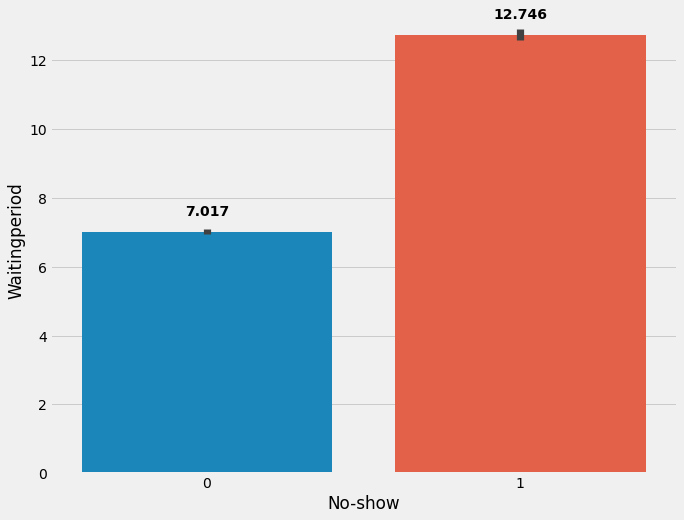

In [126]:
plt.rcParams['figure.figsize'] = (10,8)
p1 = sns.barplot(x = df_new['No-show'], y = df_new['Waitingperiod'])
for p in p1.patches:
  p1.annotate(f'{p.get_height():0.3f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center', va = 'center', 
                      xytext = (0, 20), textcoords = 'offset points', weight = 'bold')
plt.show()

Here we see that the waiting period for those who show up for the appointment is almost half the waiting period for those who donnot show up for the appointment.

In [127]:
#fig = px.box(df_new, x = 'Diabetes', y = 'Waitingperiod', color='No-show')
#fig.show()

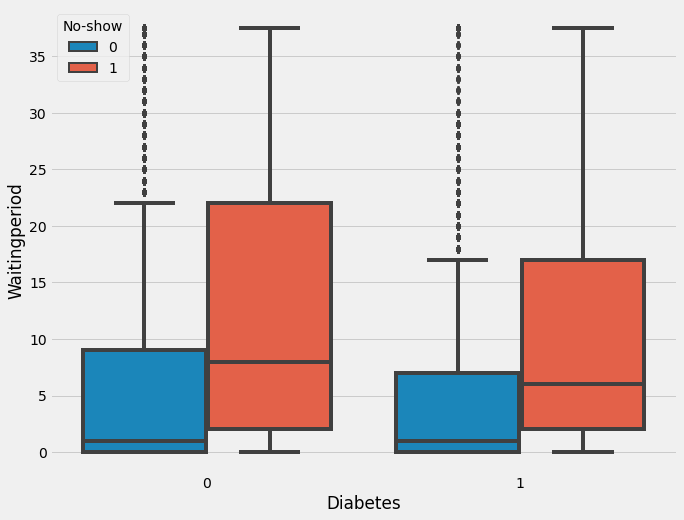

In [128]:
sns.boxplot(x=df_new['Diabetes'], y=df_new['Waitingperiod'], hue=df_new['No-show'])
plt.show()

In [129]:
#fig = px.box(df_new, x = 'Handcap', y = 'Waitingperiod', color='No-show')
#fig.show()

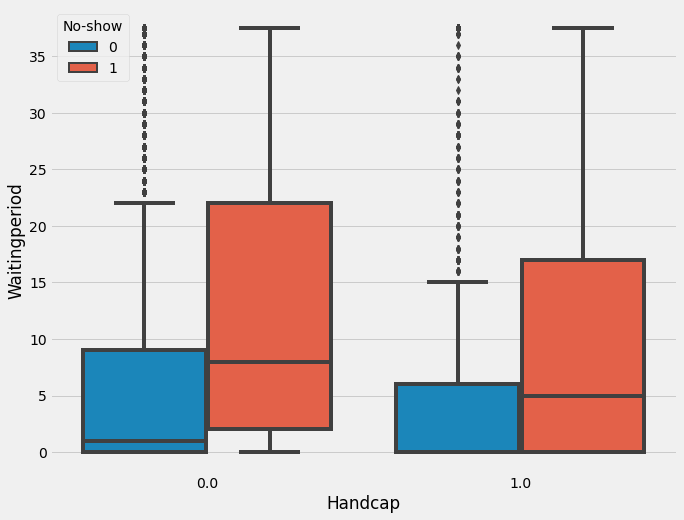

In [130]:
plt.rcParams['figure.figsize'] = (10,8)
sns.boxplot(x=df_new['Handcap'], y=df_new['Waitingperiod'], hue=df_new['No-show'])
plt.show()

In [131]:
#fig = px.box(df_new, x = 'Alcoholism', y = 'Waitingperiod', color='No-show')
#fig.show()

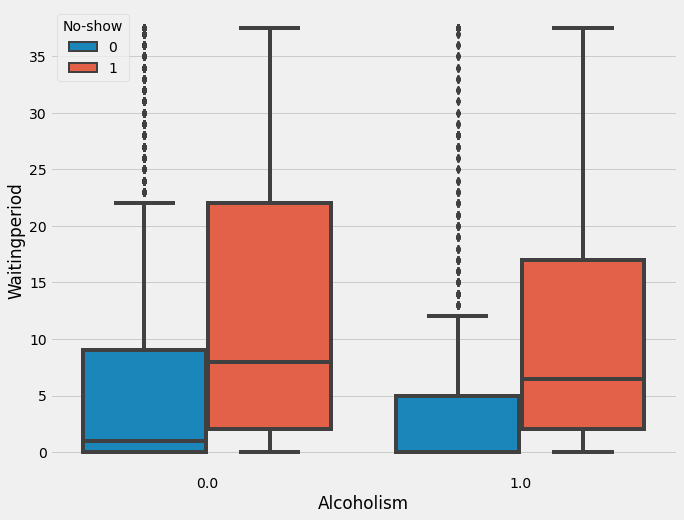

In [132]:
plt.rcParams['figure.figsize'] = (10,8)
sns.boxplot(x=df_new['Alcoholism'], y=df_new['Waitingperiod'], hue=df_new['No-show'])
plt.show()

In [133]:
#fig = px.box(df_new, x = 'Hipertension', y = 'Waitingperiod', color='No-show')
#fig.show()

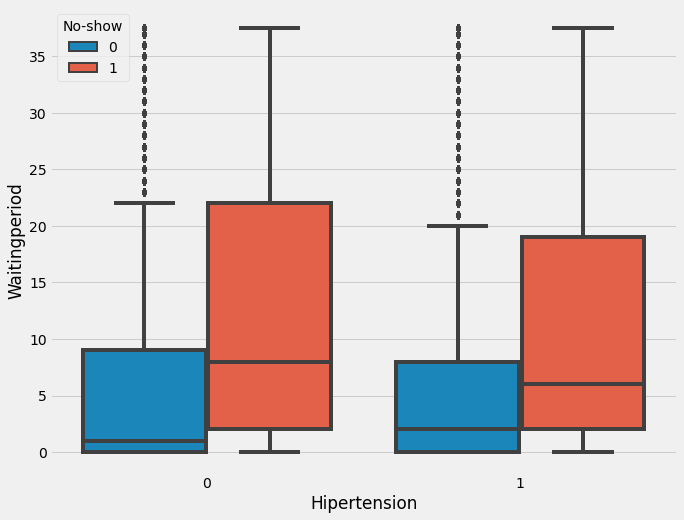

In [134]:
plt.rcParams['figure.figsize'] = (10,8)
sns.boxplot(x=df_new['Hipertension'], y=df_new['Waitingperiod'], hue=df_new['No-show'])
plt.show()

In [135]:
#fig = px.box(df_new, x = 'Scholarship', y = 'Waitingperiod', color='No-show')
#fig.show()

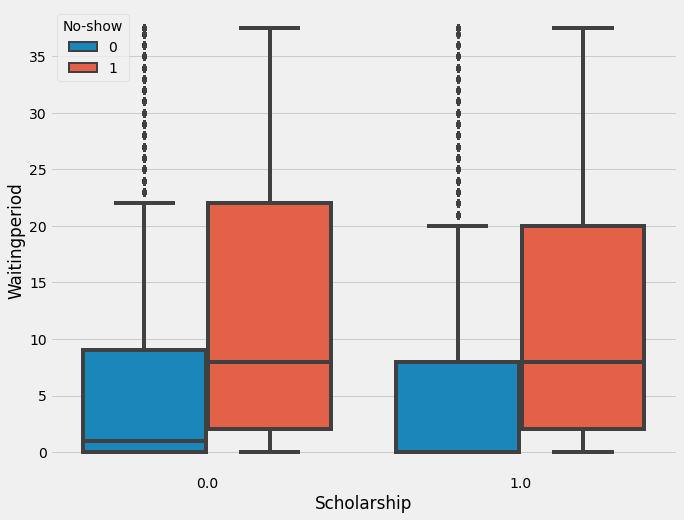

In [136]:
plt.rcParams['figure.figsize'] = (10,8)
sns.boxplot(x=df_new['Scholarship'], y=df_new['Waitingperiod'], hue=df_new['No-show'])
plt.show()

In [137]:
#fig = px.box(df_new, x = 'SMS_received', y = 'Waitingperiod', color='No-show')
#fig.show()

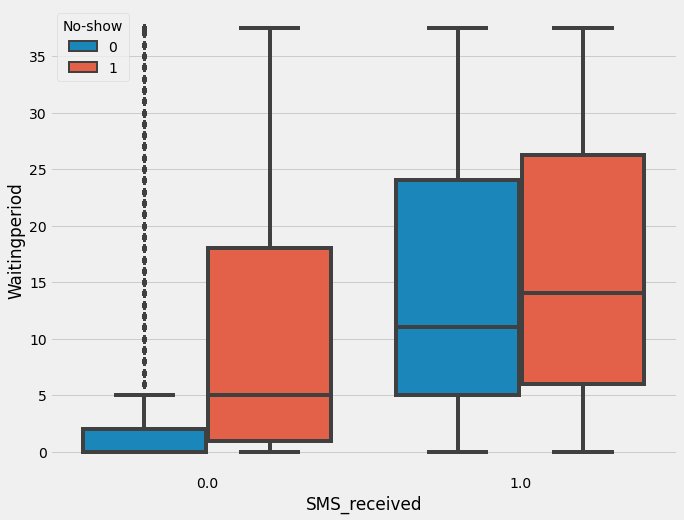

In [138]:
plt.rcParams['figure.figsize'] = (10,8)
sns.boxplot(x=df_new['SMS_received'], y=df_new['Waitingperiod'], hue=df_new['No-show'])
plt.show()

In [139]:
df_sorted2=df_pd['Neighbourhood'].sort_values(ascending=True)

In [140]:
#fig = px.box(df_new, x = df_sorted2, y = 'Waitingperiod', color='No-show')
#fig.show()

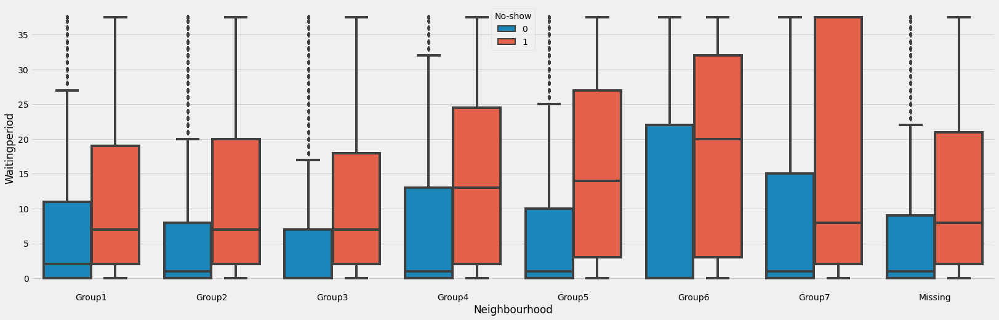

In [141]:
plt.rcParams['figure.figsize'] = (25,8)
sns.boxplot(x=df_sorted2, y=df_new['Waitingperiod'], hue=df_new['No-show'])
plt.show()

In [142]:
#fig = px.box(df_new, x = 'Diabetes', y = 'prior_appointments', color='No-show')
#fig.show()

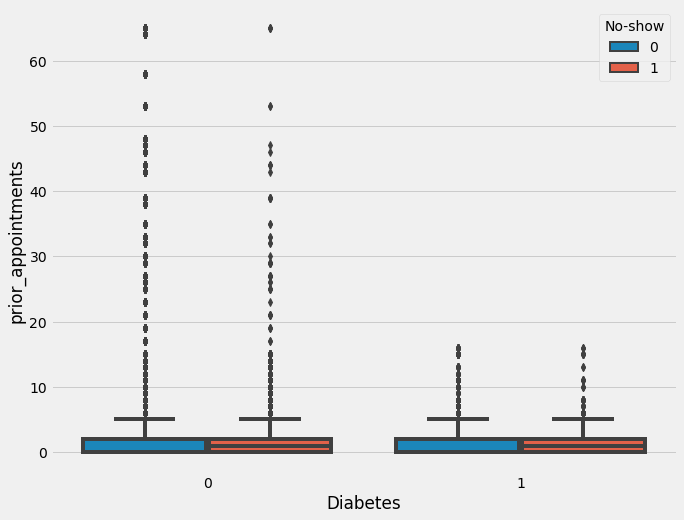

In [143]:
plt.rcParams['figure.figsize'] = (10,8)
sns.boxplot(x=df_new['Diabetes'], y=df_new['prior_appointments'], hue=df_new['No-show'])
plt.show()